## Detectron2 (Mask_RCNN) Instance Segmentation
Tutorial: https://youtu.be/e8LPflX0nwQ?si=6azoVDVoV_8sbPqd

Only works with T4 GPU because of the lack of NVIDIA in CPU mode

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-gqh8___b
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-gqh8___b
  Resolved https://github.com/facebookresearch/detectron2.git to commit f3a463104ad99e55b87422b5753ea34723ee272e
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 65.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6120548 sha256=741f898759df23d925d7012a5940

model_final_f10217.pkl: 178MB [00:01, 93.4MB/s]                          
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Time taken for instance segmentation of IMG_9085.JPG: 6.19 seconds


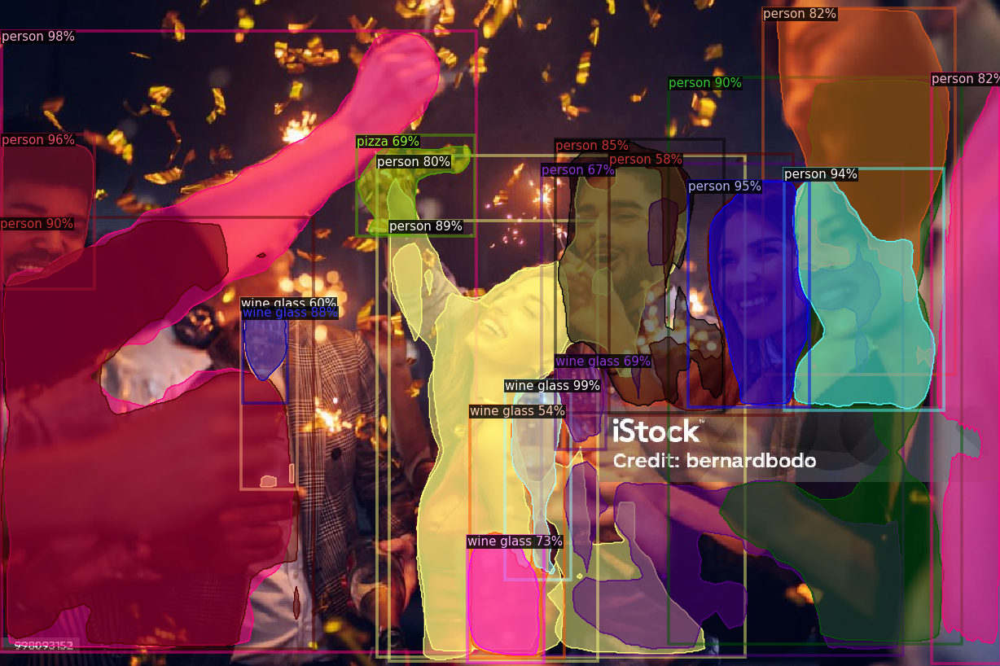

Time taken for instance segmentation of IMG_9086.JPG: 0.65 seconds


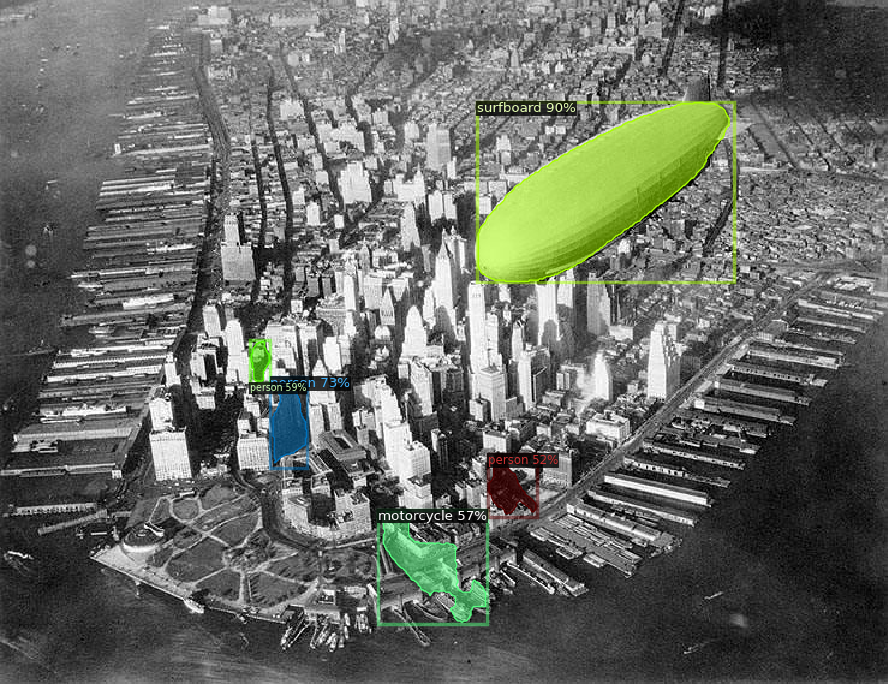

Time taken for instance segmentation of IMG_9087.JPG: 0.73 seconds


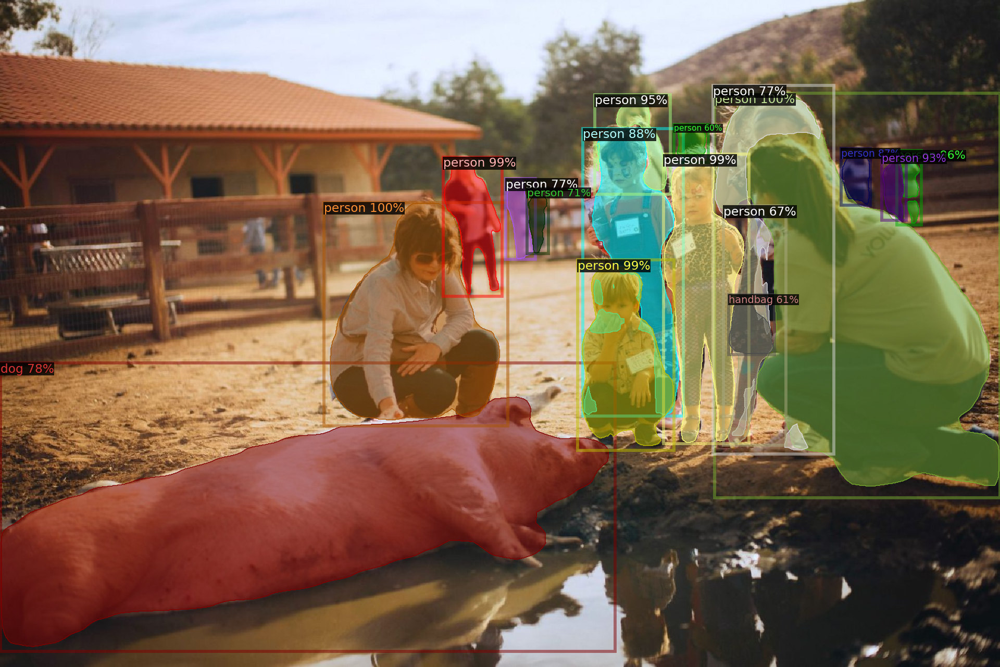

Time taken for instance segmentation of IMG_9088.JPG: 0.32 seconds


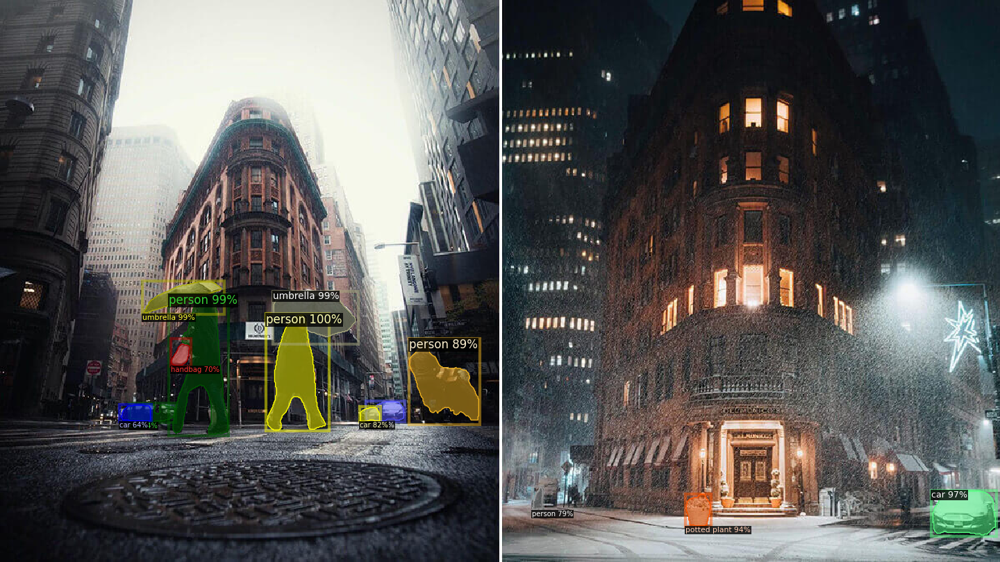

Time taken for instance segmentation of IMG_9090.JPG: 0.19 seconds


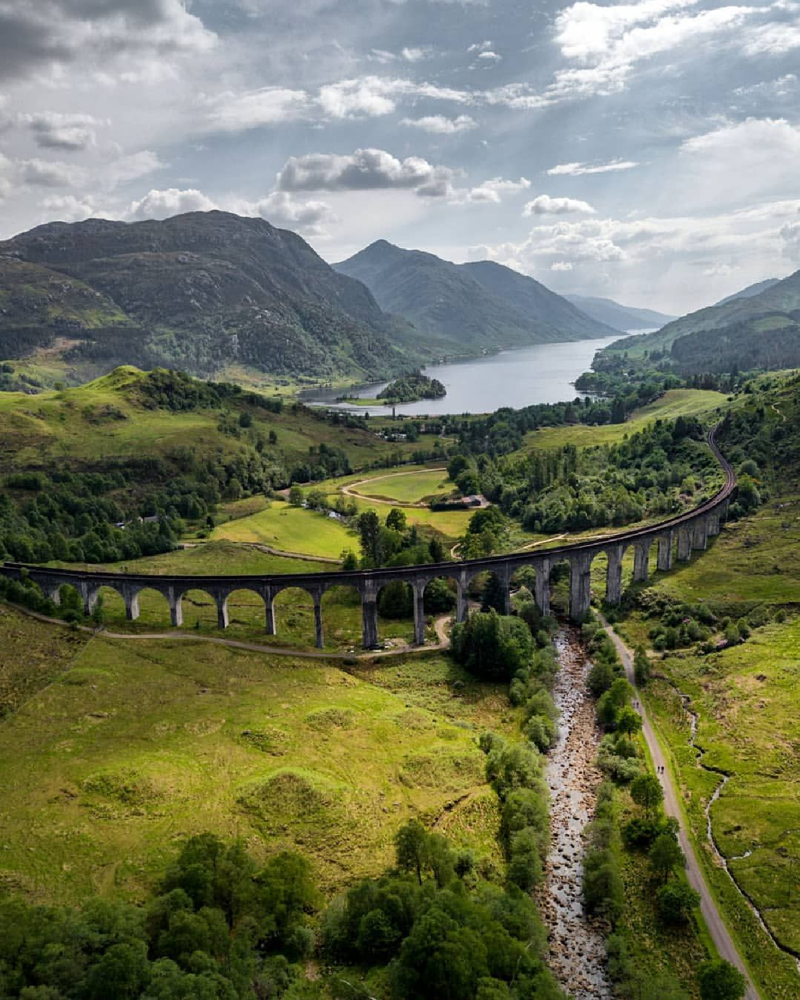

Time taken for instance segmentation of IMG_9091.jpg.png: 0.43 seconds


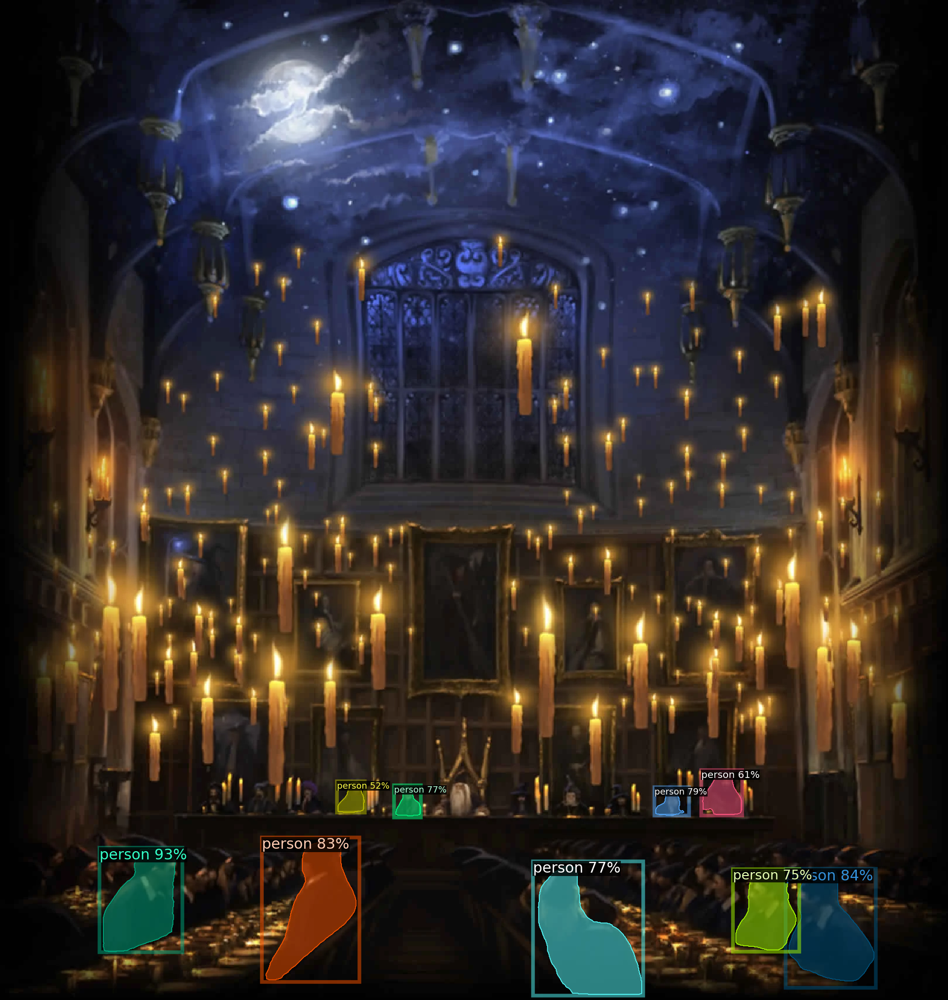

Time taken for instance segmentation of IMG_9092.JPG: 0.42 seconds


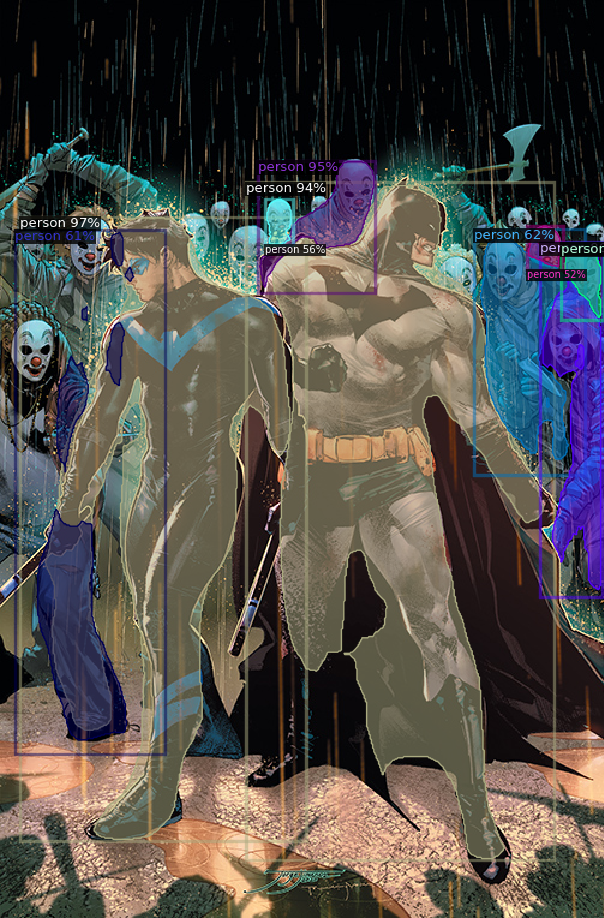

Time taken for instance segmentation of IMG_9093.JPG: 0.25 seconds


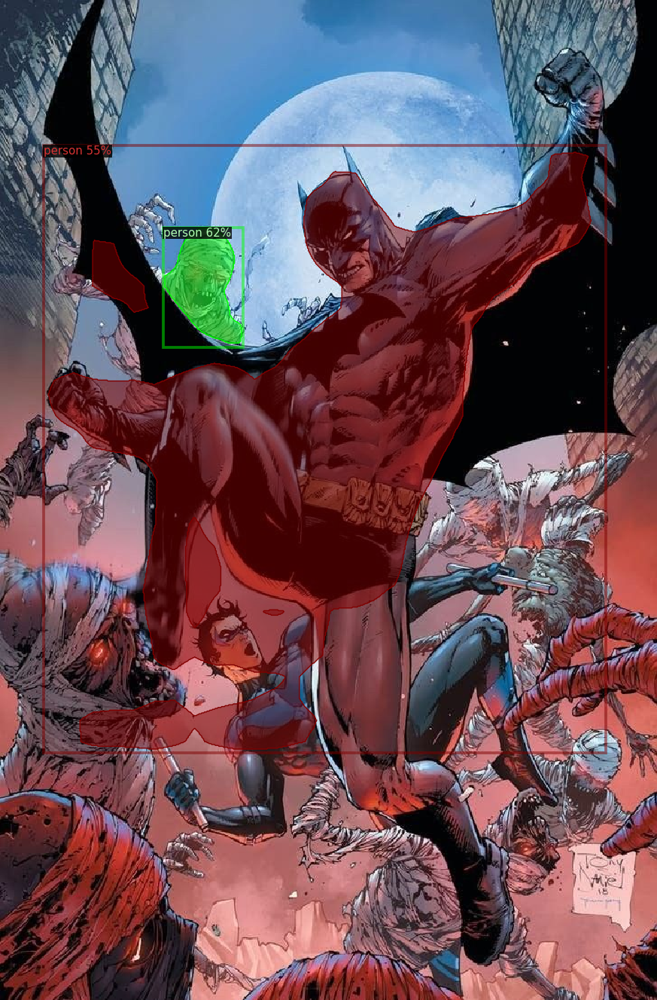

Time taken for instance segmentation of IMG_9094.JPG: 0.30 seconds


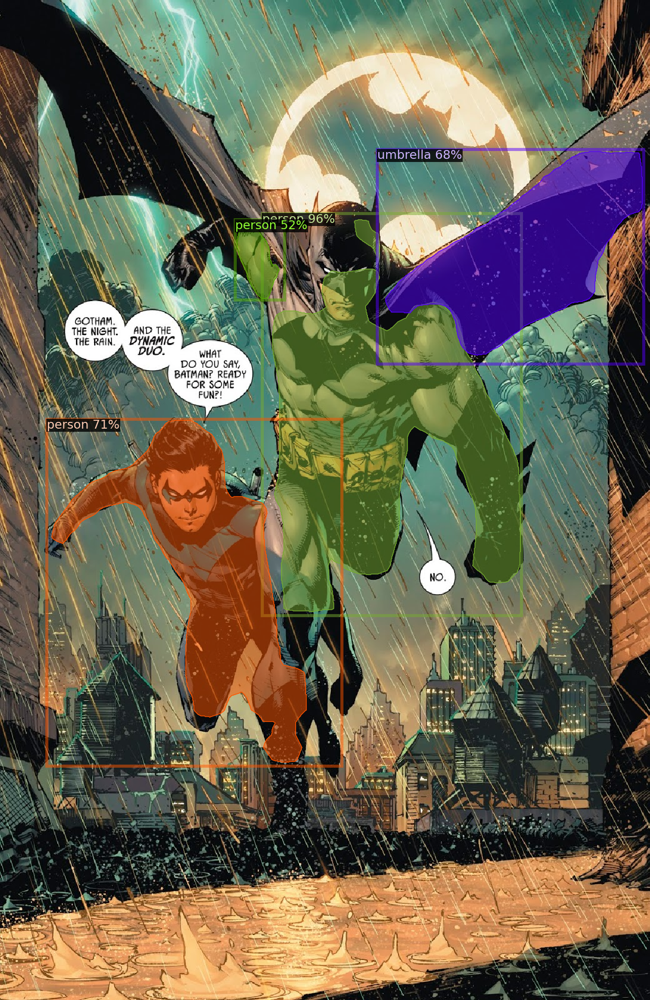

Time taken for instance segmentation of IMG_2792.PNG: 0.33 seconds


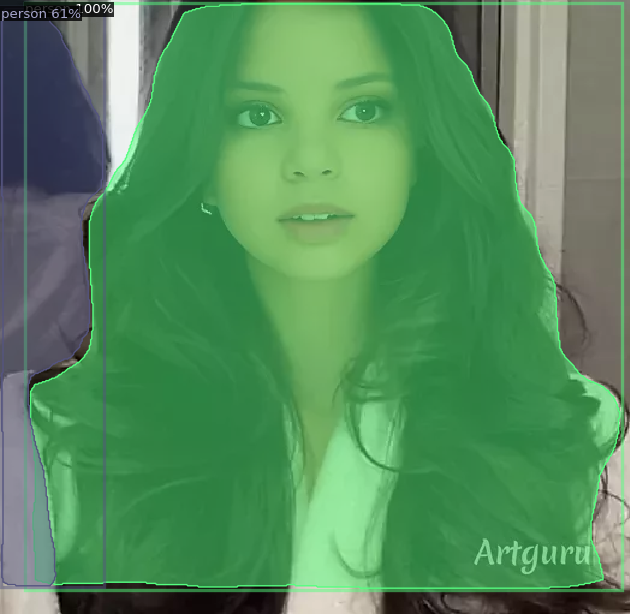

Time taken for instance segmentation of Kitchen_living_room_ideas.jpeg: 0.48 seconds


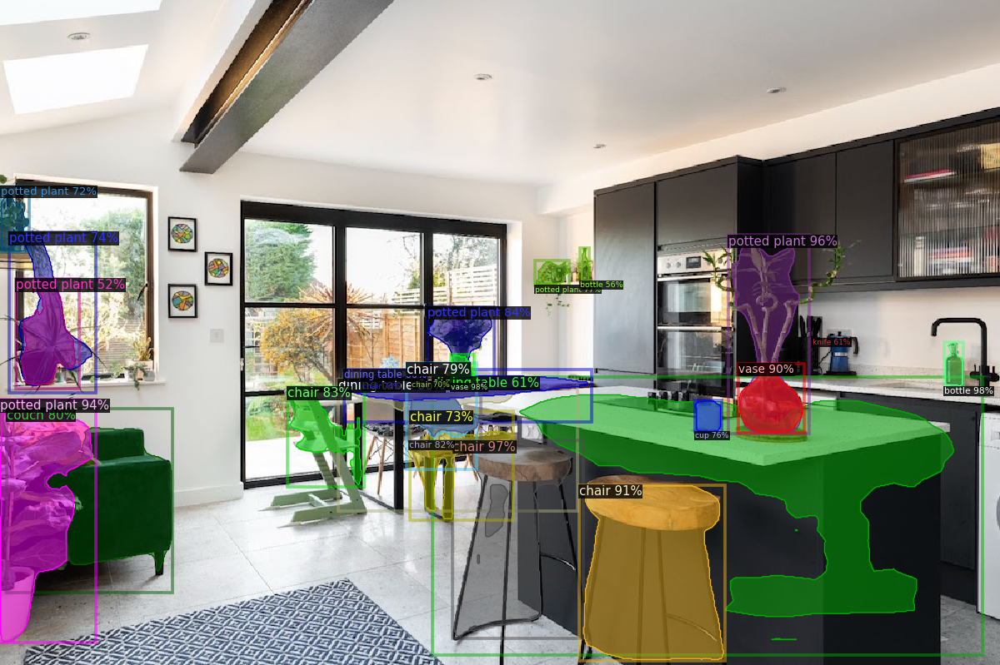

Time taken for instance segmentation of depositphotos_57161417-stock-photo-london-train-station.jpg: 0.52 seconds


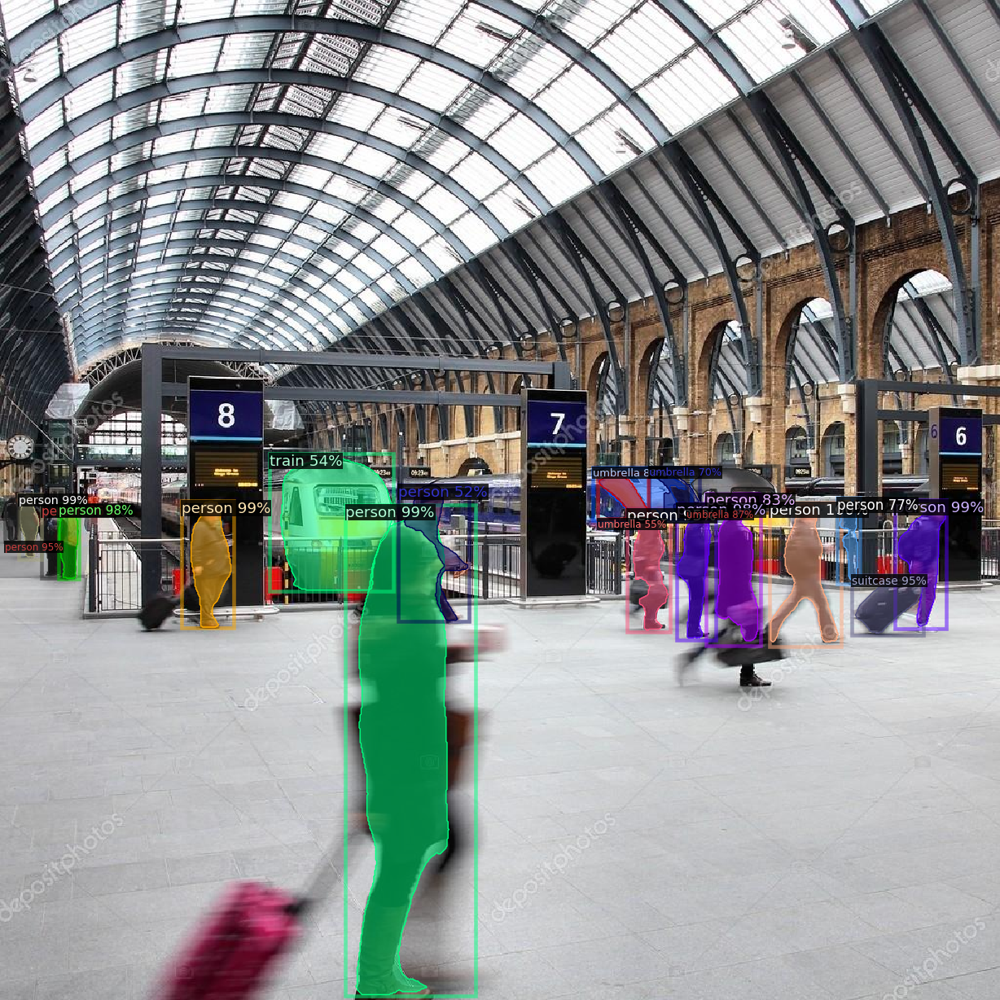

In [ ]:
import torch, detectron2
import torch, detectron2
import os
import time
import cv2
from datetime import datetime
from google.colab.patches import cv2_imshow
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer

# Path to the directory containing images
folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

times_mask_rcnn = {}

# Define function to process each image
def process_image(image_path, predictor):
    # Read the image
    image = cv2.imread(image_path)
    # Measure the start time
    start_time = time.time()
    # Perform prediction
    outputs = predictor(image)

    # Get predicted classes and boxes
    pred_classes = outputs["instances"].pred_classes
    pred_boxes = outputs["instances"].pred_boxes

    # Visualize predictions
    visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Calculate the time taken for prediction
    end_time = time.time()
    time_taken = end_time - start_time
    times_mask_rcnn[image_file] = time_taken
    print("Time taken for instance segmentation of {}: {:.2f} seconds".format(image_file, time_taken))

    # Display the image with predictions
    cv2_imshow(out.get_image()[:, :, ::-1])

# Initialize Detectron2 configuration
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)

# Get a list of all files in the directory
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    process_image(image_path, predictor)